# Speaker Diarization with Kmeans


In this implementation, we are performing speaker diarization, which involves identifying and segmenting different speakers in an audio file using K-means clustering. The audio is first processed by extracting 1-second or 2-second chunks, and then feature embeddings for each chunk are generated using a voice encoder. These embeddings are reduced to two dimensions using t-SNE for visualization. K-means clustering is then applied to group similar chunks (representing individual speakers) based on these embeddings. We also use the elbow method to determine the optimal number of clusters by calculating inertia values for different cluster counts and selecting the "knee" of the curve as the ideal cluster number. Finally, the clustering results are visualized with a scatter plot where each chunk is labeled according to its cluster, allowing for a visual representation of the speakers in the audio.

In [1]:
# Import libraries
import numpy as np
import librosa
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from IPython.display import Audio
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

In [2]:
from google.colab import drive
import os

drive.mount('/content/drive')

Mounted at /content/drive


### First audio : Two Speakers
Here we are using the first audio example. The first audio involves conversation of 2 speakers

In [3]:
# Load an example audio file
audio_path1 = "/content/drive/MyDrive/Speaker ML/testAudio.mp3"  # Example audio
y, sr = librosa.load(audio_path1, sr=None)

# Play the audio
Audio(data=y, rate=sr)

In [4]:
%%capture
!pip install resemblyzer

In [5]:
from resemblyzer import VoiceEncoder, preprocess_wav

VoiceEncoder() is typically a component of a pre-trained model used for speaker embedding. It is part of frameworks or libraries like Resemblyzer or similar tools that are designed to generate compact and meaningful representations of a speaker's voice. It processes an audio waveform to extract a fixed-size vector representation, called a *speaker embedding* or *voice embedding*. This embedding uniquely captures the characteristics of the speaker's voice, such as pitch, timbre, and speaking style. The embeddings can be compared using measures like cosine similarity to determine whether two audio segments are from the same speaker.

In [6]:
%%capture
encoder = VoiceEncoder()
y, sr = librosa.load(audio_path1, sr=None)

### 1 second chunks
This code divides the audio into 1-second chunks (specified by sr*1), processes each chunk with preprocess_wav, and generates embeddings using a VoiceEncoder.
These embeddings represent the speaker's voice for each chunk. That means 1 chunk is equal to 1 second. If the audio is 24 seconds, then the chunks should be 24.

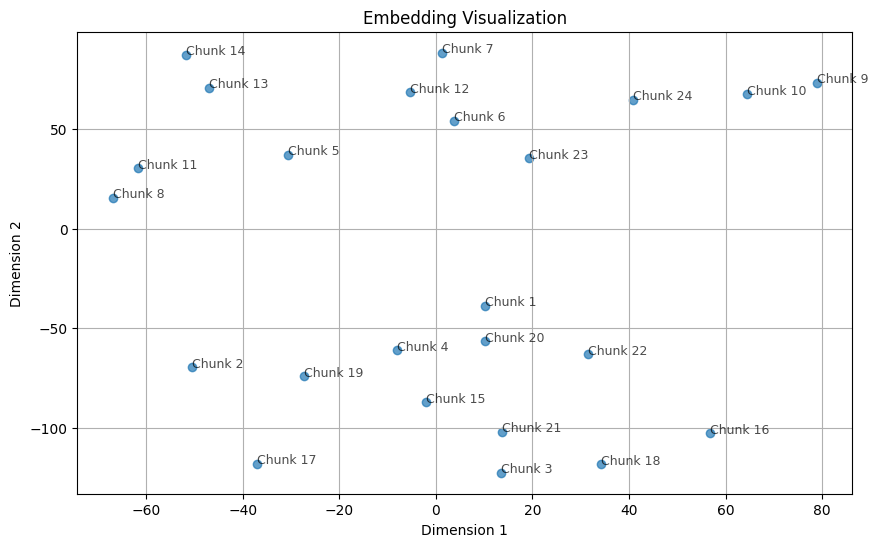

In [7]:
# Generate embeddings for different chunks or speakers.
embeddings = [encoder.embed_utterance(preprocess_wav(y[i:i+sr*1], sr)) for i in range(0, len(y), sr*1) if len(y[i:i+sr*1]) == sr*1]

# Convert to numpy array
embeddings = np.array(embeddings)

# Dimensionality reduction to 2D using t-SNE
reduced_embeddings = TSNE(n_components=2, perplexity=5, random_state=42).fit_transform(embeddings)  # Use t-SNE

# Plot the reduced embeddings
plt.figure(figsize=(10, 6))
plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], alpha=0.7)
for i, (x, y) in enumerate(reduced_embeddings):
    plt.text(x, y, f"Chunk {i+1}", fontsize=9, alpha=0.7)  # Label each point
plt.title("Embedding Visualization")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")
plt.grid(True)
plt.show()

We first manually assign the number of clusters. In this case, number of clusters is set to 2 since there are two speakers in the audio.

In [8]:
X = reduced_embeddings

In [9]:
kmeans = KMeans(
    init = "k-means++",   # another option is "random"
    n_clusters = 2,
    n_init = "auto",
    max_iter = 100,
    random_state = 42
)

kmeans.fit(X)

print(kmeans.inertia_)
print(kmeans.n_iter_)
print(kmeans.labels_)

51407.78515625
3
[1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0]


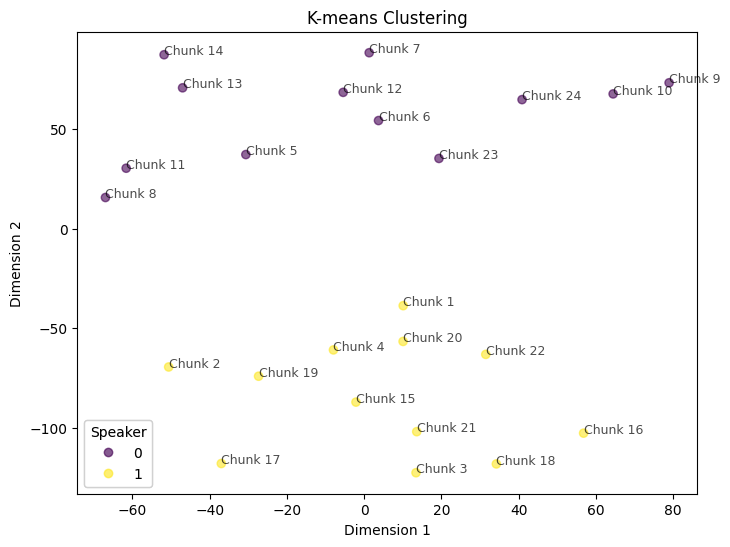

In [10]:
# Visualization
plt.figure(figsize=(8, 6))

# Scatter plot with cluster assignments
scatter_clusters = plt.scatter(X[:, 0], X[:, 1], c=kmeans.labels_, cmap='viridis', alpha=0.6)


for i, (x, y) in enumerate(X):
    plt.text(x, y, f"Chunk {i+1}", fontsize=9, alpha=0.7)  # Label each point

plt.title("K-means Clustering")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

# Create legend for clusters
legend = plt.legend(*scatter_clusters.legend_elements(),
                    loc="lower left", title="Speaker")
plt.gca().add_artist(legend)

plt.show()

This scatter plot visualizes the data points colored by the cluster they belong to, showing how the embeddings are grouped after clustering. As you can see here, chunk 1 to chunk 4 is classified into one speaker group because speaker 1 who speaks in the audio in the first 4 seconds. The results are accurate.

### Second audio : 3 speakers
Here, we are using an audio that includes conversation of 3 speakers.
(NOTE: The audio is actually created by 1 student but with 3 different voices and pitch. Thus, there might be some noises in the result, but the overall accuracy is still good.)

In [11]:
# Load an example audio file
audio_path1 = "/content/drive/MyDrive/Speaker ML/testingAudio.mp3"  # Example audio
y, sr = librosa.load(audio_path1, sr=None)

# Play the audio
Audio(data=y, rate=sr)

In [12]:
%%capture
encoder = VoiceEncoder()
y, sr = librosa.load(audio_path1, sr=None)

### 1 second chunks

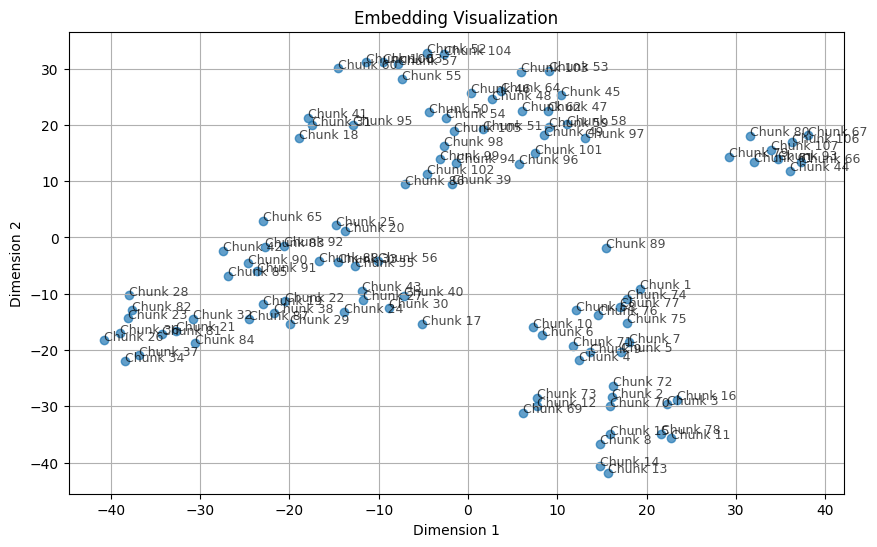

In [13]:
# Generate embeddings for different chunks or speakers.
embeddings = [encoder.embed_utterance(preprocess_wav(y[i:i+sr*1], sr)) for i in range(0, len(y), sr*1) if len(y[i:i+sr*1]) == sr*1]

# Convert to numpy array
embeddings = np.array(embeddings)

# Dimensionality reduction to 2D using t-SNE
reduced_embeddings = TSNE(n_components=2, perplexity=5, random_state=42).fit_transform(embeddings)

# Plot the reduced embeddings
plt.figure(figsize=(10, 6))
plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], alpha=0.7)
for i, (x, y) in enumerate(reduced_embeddings):
    plt.text(x, y, f"Chunk {i+1}", fontsize=9, alpha=0.7)  # Label each point
plt.title("Embedding Visualization")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")
plt.grid(True)
plt.show()

In [14]:
!pip install kneed

In this part, we use the Elbow Method to determine the optimal number of clusters by evaluating the inertia (sum of squared distances from each point to its centroid) for different values of k. A plot of inertia against the number of clusters will help identify the point where the inertia starts to decrease at a slower rate (the "elbow").

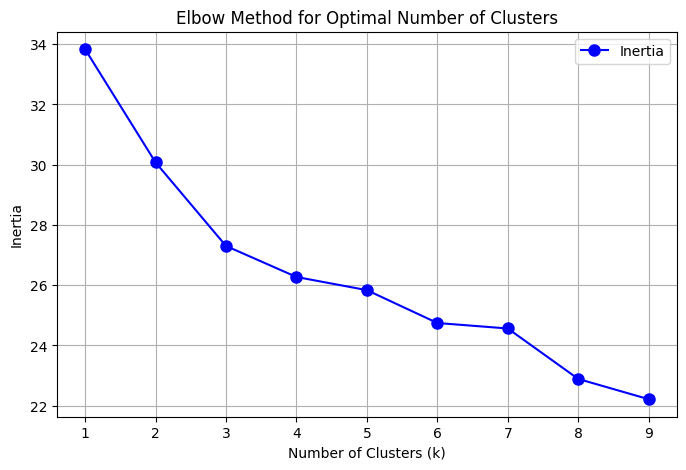

Optimal number of clusters: 3


In [15]:
# Import necessary libraries
from kneed import KneeLocator

# Define the range of cluster numbers to test
cluster_range = range(1, 10)  # Test k values from 1 to 9
inertia_values = []

# Calculate inertia for each k
for k in cluster_range:
    kmeans = KMeans(init="k-means++", n_clusters=k, random_state=42, n_init="auto", max_iter=100)
    kmeans.fit(embeddings)
    inertia_values.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure(figsize=(8, 5))
plt.plot(cluster_range, inertia_values, 'bo-', markersize=8, label="Inertia")
plt.title("Elbow Method for Optimal Number of Clusters")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia")
plt.grid()
plt.legend()
plt.show()

# Find the optimal number of clusters using KneeLocator
knee_locator = KneeLocator(cluster_range, inertia_values, curve="convex", direction="decreasing")
optimal_k = knee_locator.knee
print(f"Optimal number of clusters: {optimal_k}")

This code performs K-means clustering with the optimal number of clusters obtained from the elbow method.

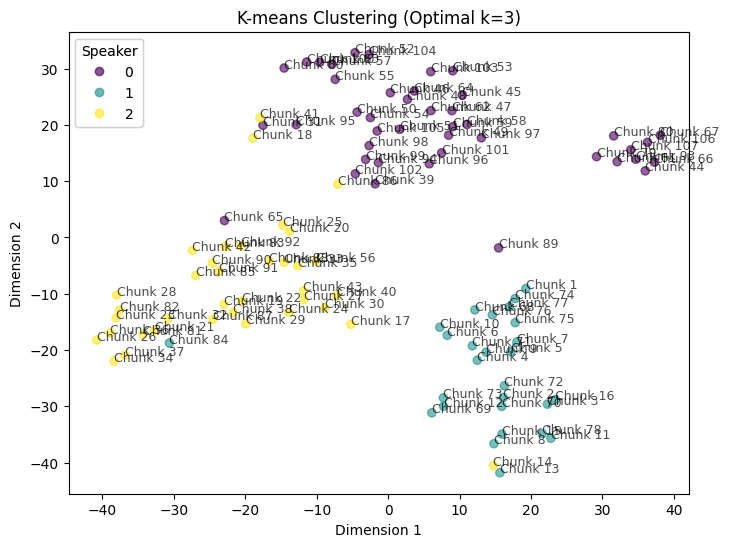

In [16]:
# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(
    init="k-means++",
    n_clusters=optimal_k,
    random_state=42,
    n_init="auto",
    max_iter=100
)
kmeans.fit(embeddings)

# Visualization of clustering results
plt.figure(figsize=(8, 6))

# Scatter plot with cluster assignments
scatter_clusters = plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=kmeans.labels_, cmap='viridis', alpha=0.6)

for i, (x, y) in enumerate(reduced_embeddings):
    plt.text(x, y, f"Chunk {i+1}", fontsize=9, alpha=0.7)  # Label each point

# Add titles and labels
plt.title(f"K-means Clustering (Optimal k={optimal_k})")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

# Create legend for clusters
legend = plt.legend(*scatter_clusters.legend_elements(),
                    loc="upper left", title="Speaker")
plt.gca().add_artist(legend)

plt.show()

The scatter plot shows the final clustering result, with points colored according to their assigned cluster. So we can obviously notice that there are 3 speakers here and each chunk represents each second that tehy speak. There is some noises in the clustering which affects the accuracy. It is because of the audio is just created by 1 student so there might be some seconds the voice is captured wrongly. But the overall visualisation still give a good accuracy.

### 2 seconds chuncks
We try to change the chunk size from 1 second to 2 seconds (specified by sr*2). It processes the audio in 2-second intervals and generates embeddings accordingly. This means 2 seconds are represented by 1 chunk. If we have an audio with 160 seconds, then the total chunks would be 80.

In [17]:
audio_path1 = "/content/drive/MyDrive/Speaker ML/testingAudio.mp3"  # Example audio
y, sr = librosa.load(audio_path1, sr=None)

# Play the audio
Audio(data=y, rate=sr)


In [18]:
%%capture
encoder = VoiceEncoder()
y, sr = librosa.load(audio_path1, sr=None)

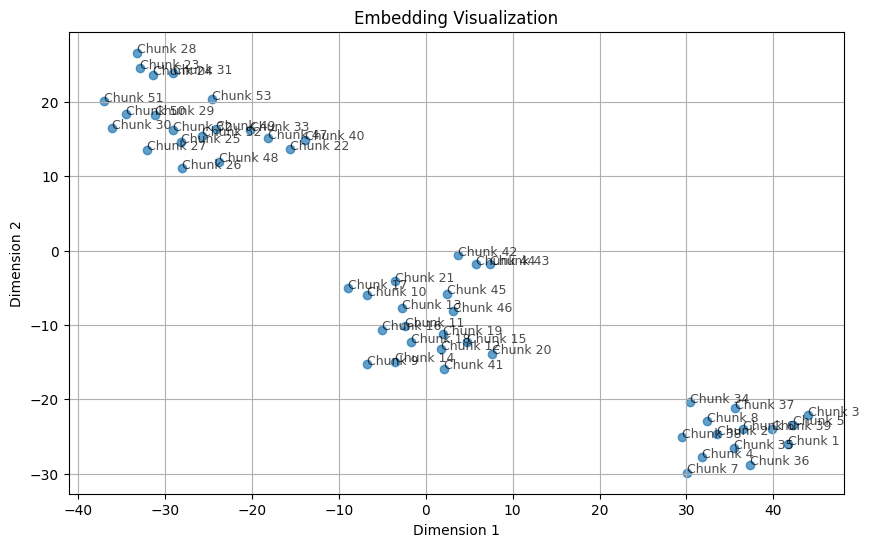

In [19]:
# Generate embeddings for different chunks or speakers.
embeddings = [encoder.embed_utterance(preprocess_wav(y[i:i+sr*2], sr)) for i in range(0, len(y), sr*2) if len(y[i:i+sr*2]) == sr*2]

# Convert to numpy array
embeddings = np.array(embeddings)

# Dimensionality reduction to 2D using t-SNE or PCA
# Uncomment one of the following lines:
# reduced_embeddings = PCA(n_components=2).fit_transform(embeddings)  # Use PCA
reduced_embeddings = TSNE(n_components=2, perplexity=5, random_state=42).fit_transform(embeddings)  # Use t-SNE

# Plot the reduced embeddings
plt.figure(figsize=(10, 6))
plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], alpha=0.7)
for i, (x, y) in enumerate(reduced_embeddings):
    plt.text(x, y, f"Chunk {i+1}", fontsize=9, alpha=0.7)  # Label each point
plt.title("Embedding Visualization")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")
plt.grid(True)
plt.show()


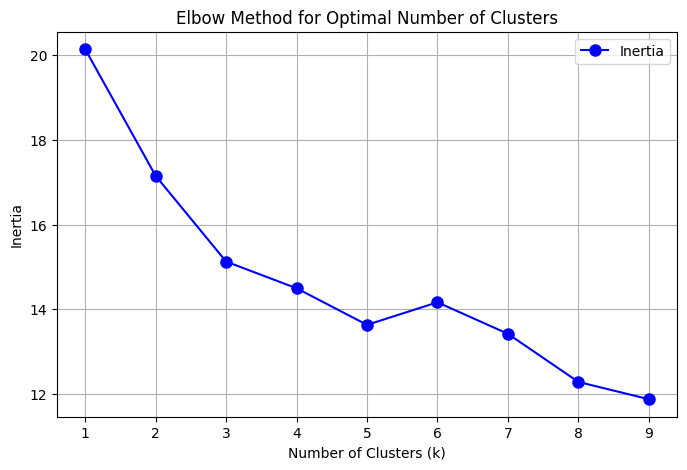

Optimal number of clusters: 3


In [20]:
# Import necessary libraries
from kneed import KneeLocator

# Define the range of cluster numbers to test
cluster_range = range(1, 10)  # Test k values from 1 to 9
inertia_values = []

# Calculate inertia for each k
for k in cluster_range:
    kmeans = KMeans(init="k-means++", n_clusters=k, random_state=42, n_init="auto", max_iter=100)
    kmeans.fit(embeddings)
    inertia_values.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure(figsize=(8, 5))
plt.plot(cluster_range, inertia_values, 'bo-', markersize=8, label="Inertia")
plt.title("Elbow Method for Optimal Number of Clusters")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia")
plt.grid()
plt.legend()
plt.show()

# Find the optimal number of clusters using KneeLocator
knee_locator = KneeLocator(cluster_range, inertia_values, curve="convex", direction="decreasing")
optimal_k = knee_locator.knee
print(f"Optimal number of clusters: {optimal_k}")

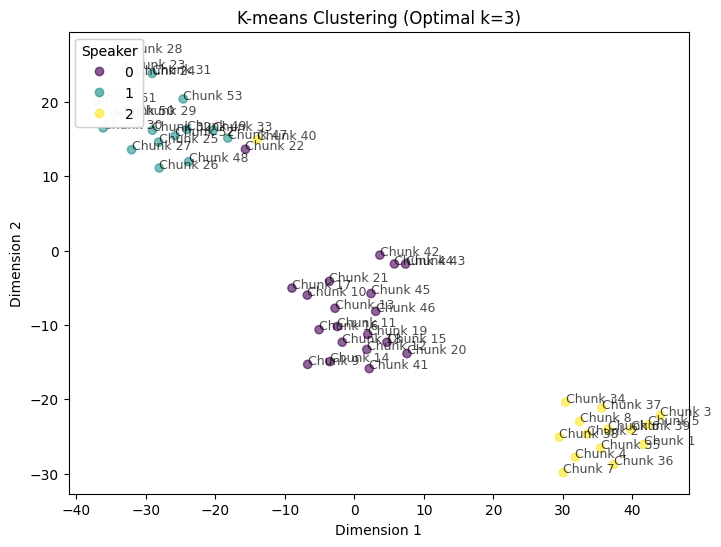

In [21]:
# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(
    init="k-means++",
    n_clusters=optimal_k,
    random_state=42,
    n_init="auto",
    max_iter=100
)
kmeans.fit(embeddings)

# Visualization of clustering results
plt.figure(figsize=(8, 6))

# Scatter plot with cluster assignments
scatter_clusters = plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=kmeans.labels_, cmap='viridis', alpha=0.6)

for i, (x, y) in enumerate(reduced_embeddings):
    plt.text(x, y, f"Chunk {i+1}", fontsize=9, alpha=0.7)  # Label each point

# Add titles and labels
plt.title(f"K-means Clustering (Optimal k={optimal_k})")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

# Create legend for clusters
legend = plt.legend(*scatter_clusters.legend_elements(),
                    loc="upper left", title="Speaker")
plt.gca().add_artist(legend)

plt.show()

The scatter plot shows the final clustering result, with points colored according to their assigned cluster. So we can obviously notice that there are 3 speakers here and each chunk represents each second that tehy speak. There is some noises in the clustering which affects the accuracy. It is because of the audio is just created by 1 student so there might be some seconds the voice is captured wrongly. But the overall visualisation still give a good accuracy.

### Conclusion
We successfully implemented a speaker diarization system leveraging K-means clustering and a pre-trained voice encoder. The voice encoder extracted meaningful speaker embeddings from audio chunks, capturing unique vocal characteristics. These embeddings were then clustered using K-means to group audio segments by speaker identity. The approach demonstrated the power of unsupervised learning combined with pre-trained models in tackling tasks like speaker diarization without requiring extensive labeled datasets. This implementation provides a foundation for applications in transcription services, meeting summarization, and audio analysis, paving the way for more efficient and scalable solutions in speaker recognition.